<a href="https://colab.research.google.com/github/sergiomh499/Vulkan_AI_test/blob/main/vulkan_ai_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# VULKAN AI - TENSORFLOW LAYERS TEST

IMPORT:

In [53]:
import cv2
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow
from tensorflow.keras.layers import  ReLU, Conv2D, BatchNormalization

PARAMETERS:

In [58]:
input_image_path = "./images/beluga.jpg"
output_image_dir = "./results/"

LOAD IMAGE:

In [84]:
input_image = cv2.imread(input_image_path)
input_list = []
input_list.append(input_image) # created list input to layer
input_list_shape = np.shape(input_list)
input_tensor = tf.convert_to_tensor(input_image, dtype=tf.float32)

ReLU TEST:

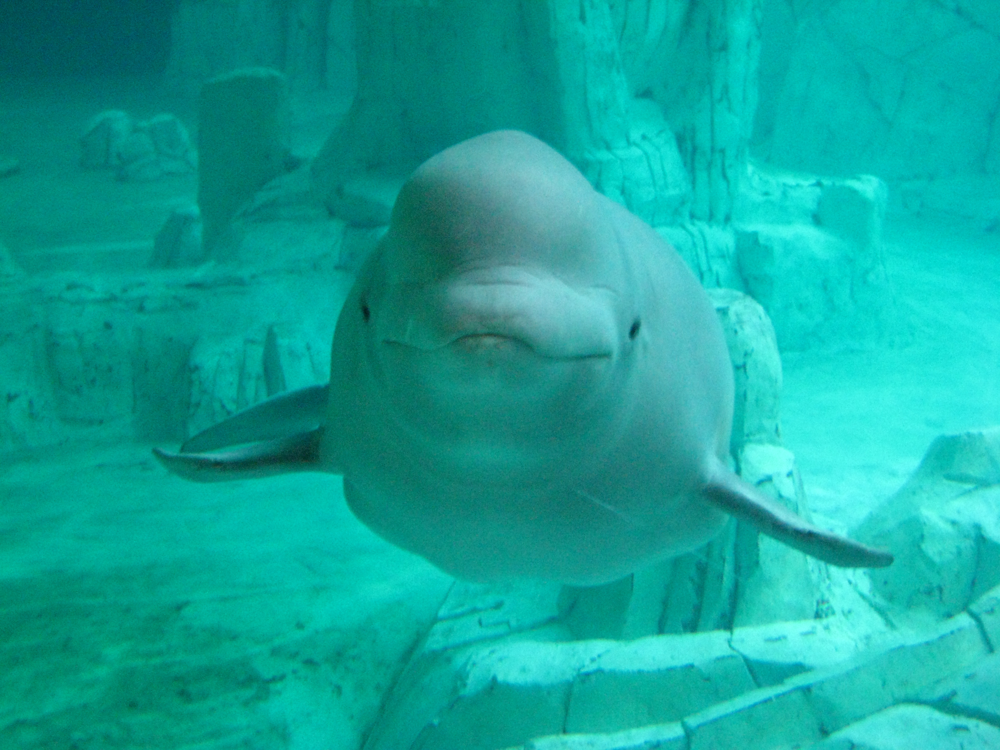

True

In [170]:
# assign layer
layer = ReLU(
    max_value=None, 
    negative_slope=0.0, 
    threshold=0.0
)

# apply layer
output_tensor = layer(input_list)

# process output
output_np = output_tensor.numpy()
output_list = list(output_np)
output_shape = np.shape(output_np)
output_img = output_np[0,:,:,:]

# show and save output
cv2_imshow(output_img)
cv2.imwrite(output_image_dir + "ReLU.png", output_img)

Batch Normalization TEST:

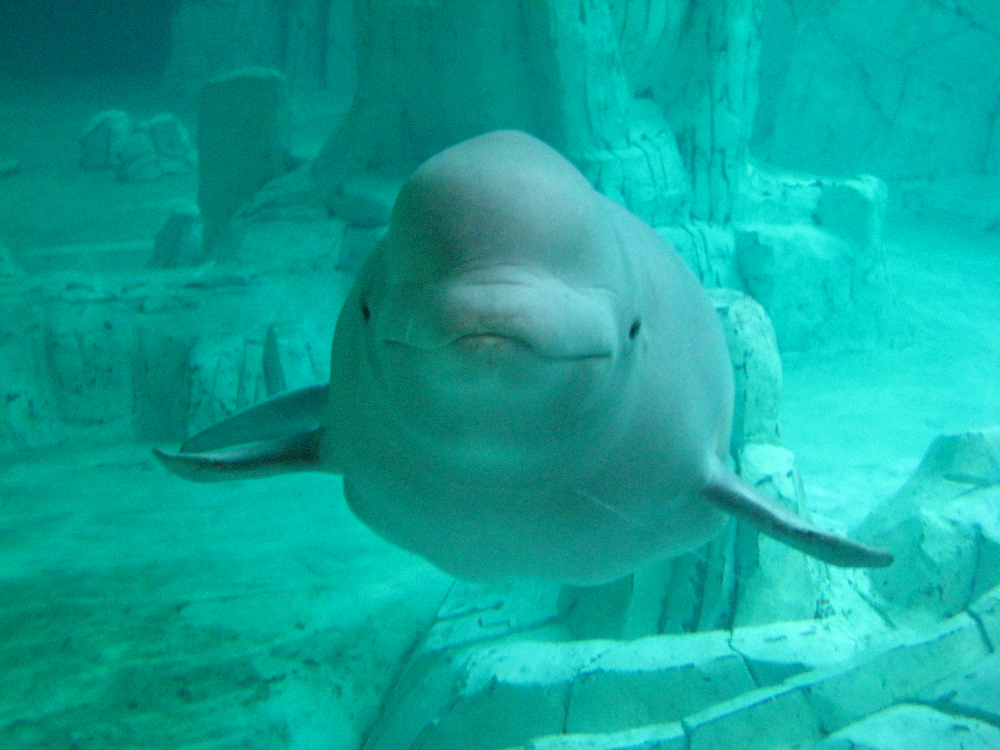

True

In [70]:
# assign layer
layer = BatchNormalization(
    axis=-1,
    momentum=0.99,
    epsilon=0.001,
    center=True,
    scale=True,
    beta_initializer='zeros',
    gamma_initializer='ones',
    moving_mean_initializer='zeros',
    moving_variance_initializer='ones'
)

# apply layer
output_tensor = layer(input_tensor)

# process output
output_np = output_tensor.numpy()
output_list = list(output_np)
output_shape = np.shape(output_np)
output_img = output_np[:,:,:]

# show and save output
cv2_imshow(output_img)
cv2.imwrite(output_image_dir + "BatchNormalization.png", output_img)

Convolution TEST:

(3, 3, 3)


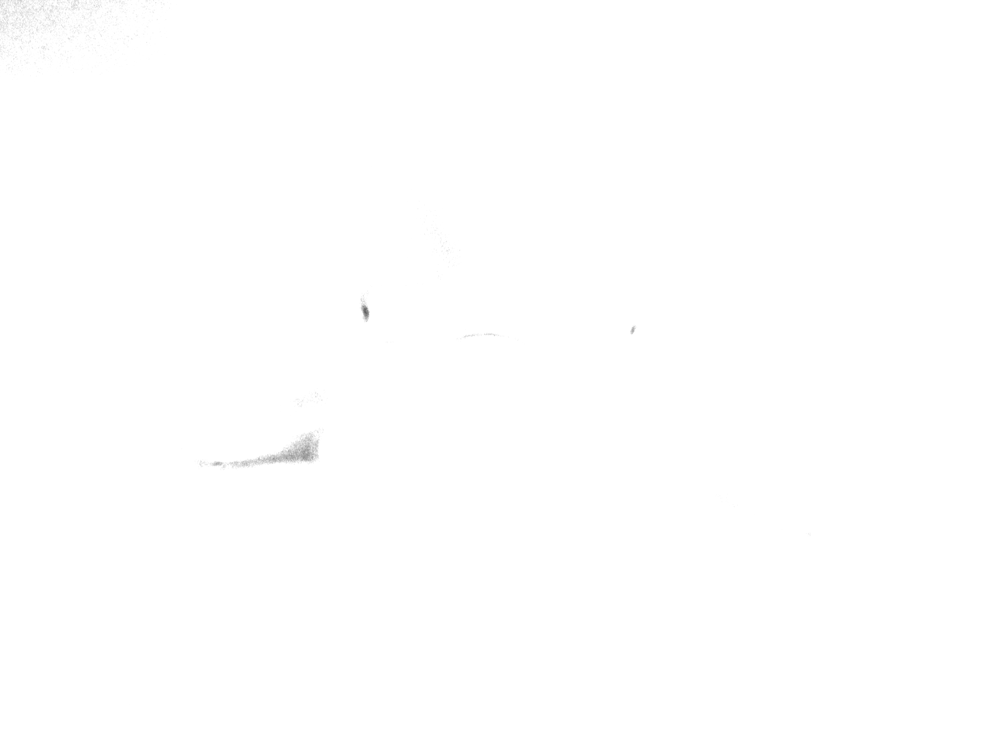

True

In [169]:
kernel = [[[1, 0, -1],
           [1, 0, -1],
           [1, 0, -1]],
          [[1, 0, -1],
           [1, 0, -1],
           [1, 0, -1]],
          [[1, 0, -1],
           [1, 0, -1],
           [1, 0, -1]]]

kernel = [[[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]],
          [[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]],
          [[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]]]

print(np.shape(kernel))


# assign layer
layer = Conv2D(
    filters=1,
    kernel_size=(3, 3)
)
layer.build(input_shape=input_list_shape)
kernel_batch = tf.reshape(kernel,
                          (3, 3, 3, 1))
layer.set_weights([kernel_batch, np.zeros((1))])

# apply layer
input_batch_tensor = tf.reshape(input_tensor, 
                              (-1, input_list_shape[1], input_list_shape[2], input_list_shape[3]))
output_tensor = layer(input_batch_tensor)

# process output
output_np = output_tensor.numpy()
output_list = list(output_np)
output_shape = np.shape(output_np)
output_img = output_np[0,:,:,:]

# show and save output
cv2_imshow(output_img)
cv2.imwrite(output_image_dir + "Convolution.png", output_img)

Convolution + ReLU + BatchNormalization TEST:

(3, 3, 3)


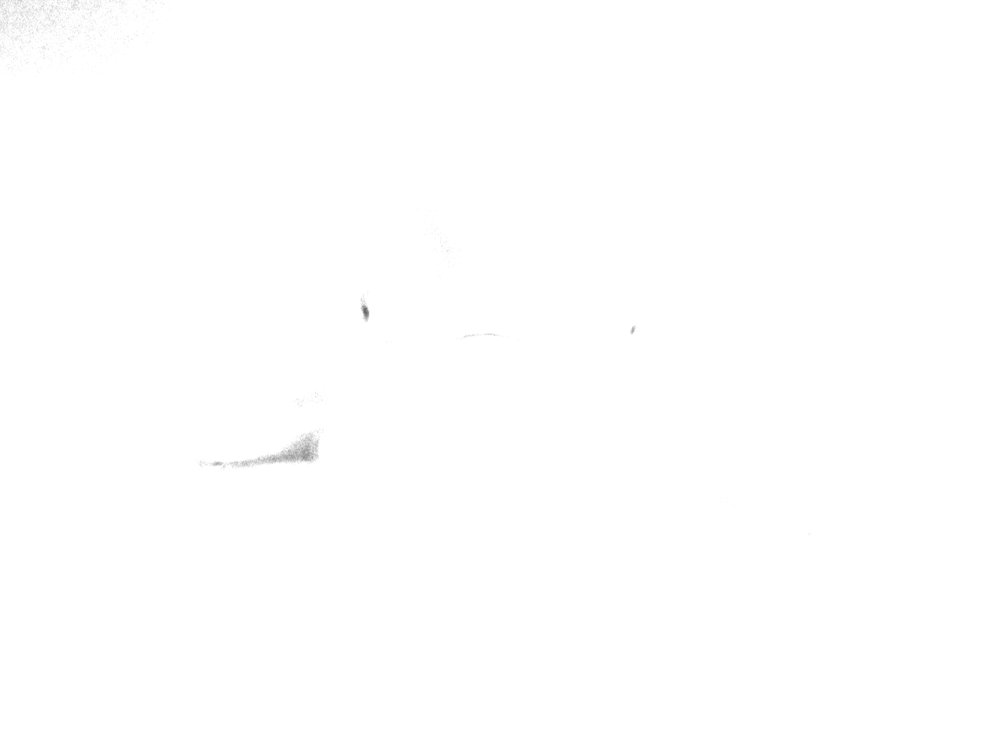

True

In [172]:
kernel = [[[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]],
          [[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]],
          [[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]]]

print(np.shape(kernel))


# assign layer
layer1 = Conv2D(
    filters=1,
    kernel_size=(3, 3)
)
layer1.build(input_shape=input_list_shape)
kernel_batch = tf.reshape(kernel,
                          (3, 3, 3, 1))
layer1.set_weights([kernel_batch, np.zeros((1))])

layer2 = ReLU(
    max_value=None, 
    negative_slope=0.0, 
    threshold=0.0
)

layer3 = BatchNormalization(
    axis=-1,
    momentum=0.99,
    epsilon=0.001,
    center=True,
    scale=True,
    beta_initializer='zeros',
    gamma_initializer='ones',
    moving_mean_initializer='zeros',
    moving_variance_initializer='ones'
)


# apply layer
input_batch_tensor = tf.reshape(input_tensor, 
                              (-1, input_list_shape[1], input_list_shape[2], input_list_shape[3]))
output_tensor = layer1(input_batch_tensor)
output_tensor = layer2(output_tensor)
output_tensor = layer3(output_tensor)

# process output
output_np = output_tensor.numpy()
output_list = list(output_np)
output_shape = np.shape(output_np)
output_img = output_np[0,:,:,:]

# show and save output
cv2_imshow(output_img)
cv2.imwrite(output_image_dir + "Conv_ReLU_BN.png", output_img)